# TACO Inspection Demo

This notebook contains several independent scripts that show how to load and visualize the dataset stats and annotated images:
- Section 1 shows the dataset stats
- Section 2 show the class hierarchical structure: super classes and classes
- Section 3 shows TACO images along with their segmentation masks

But first we need to load the annotations and some python libraries:

In [1]:
%matplotlib inline
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

dataset_path = './data'
anns_file_path = dataset_path + '/' + 'annotations.json'

# Read annotations
with open(anns_file_path, 'r') as f:
    dataset = json.loads(f.read())

categories = dataset['categories']
anns = dataset['annotations']
imgs = dataset['images']
nr_cats = len(categories)
nr_annotations = len(anns)
nr_images = len(imgs)

# Load categories and super categories
cat_names = []
super_cat_names = []
super_cat_ids = {}
super_cat_last_name = ''
nr_super_cats = 0
for cat_it in categories:
    cat_names.append(cat_it['name'])
    super_cat_name = cat_it['supercategory']
    # Adding new supercat
    if super_cat_name != super_cat_last_name:
        super_cat_names.append(super_cat_name)
        super_cat_ids[super_cat_name] = nr_super_cats
        super_cat_last_name = super_cat_name
        nr_super_cats += 1

print('Number of super categories:', nr_super_cats)
print('Number of categories:', nr_cats)
print('Number of annotations:', nr_annotations)
print('Number of images:', nr_images)

Number of super categories: 28
Number of categories: 60
Number of annotations: 4784
Number of images: 1500


## 1.  Dataset statistics

This shows the number of annotations per category:

/home/zozan-server/anaconda3/envs/segformer/lib/python3.7/site-packages/ipykernel_launcher.py:11: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_values except for the argument 'by' will be keyword-only
  # This is added back by InteractiveShellApp.init_path()


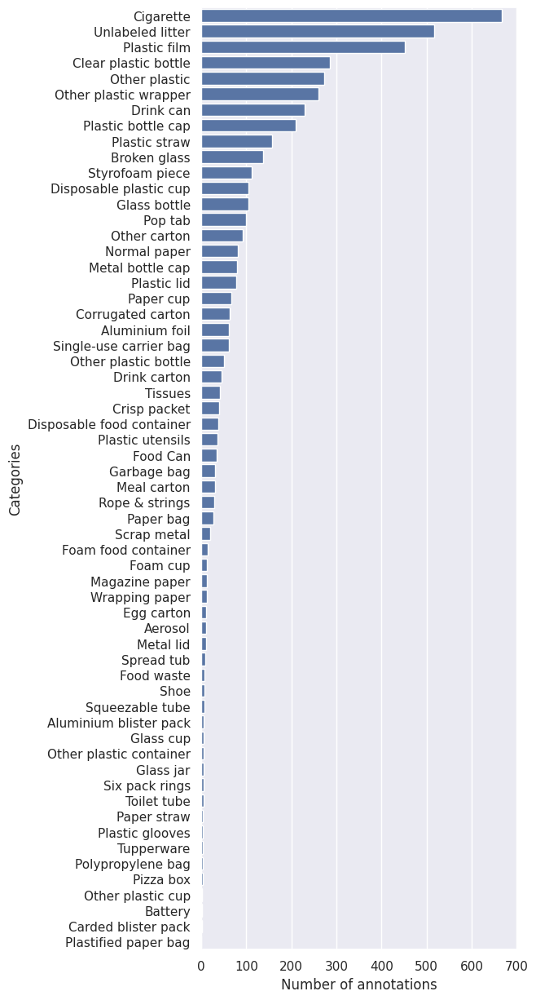

In [2]:
# Count annotations
cat_histogram = np.zeros(nr_cats,dtype=int)
for ann in anns:
    cat_histogram[ann['category_id']] += 1

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(5,15))

# Convert to DataFrame
df = pd.DataFrame({'Categories': cat_names, 'Number of annotations': cat_histogram})
df = df.sort_values('Number of annotations', 0, False)

# Plot the histogram
# sns.set_color_codes("pastel")
# sns.set(style="whitegrid")
plot_1 = sns.barplot(x="Number of annotations", y="Categories", data=df,
            label="Total", color="b")

# fig = plot_1.get_figure()
# fig.savefig("output.png")

and this shows the number of annotations per super category:

/home/zozan-server/anaconda3/envs/segformer/lib/python3.7/site-packages/ipykernel_launcher.py:17: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_values except for the argument 'by' will be keyword-only
  app.launch_new_instance()


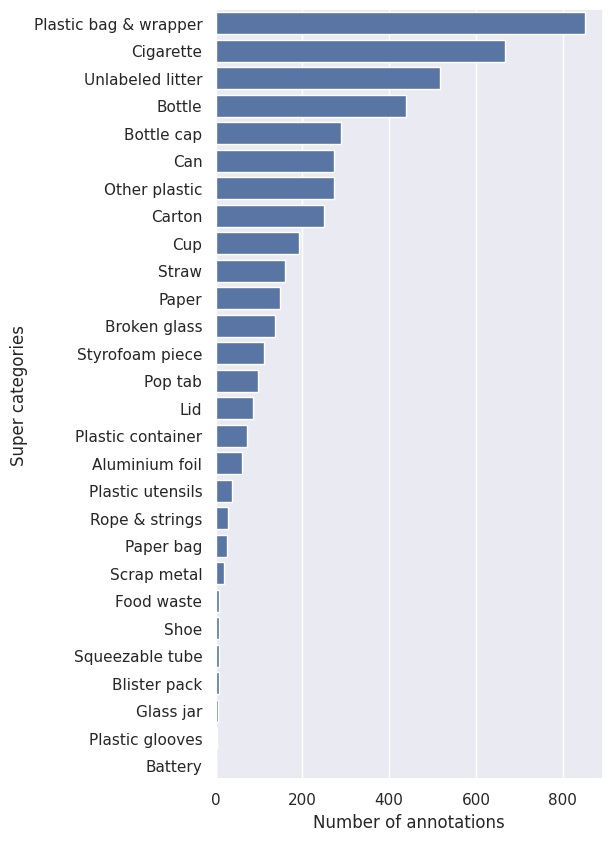

In [3]:
cat_ids_2_supercat_ids = {}
for cat in categories:
    cat_ids_2_supercat_ids[cat['id']] = super_cat_ids[cat['supercategory']]

# Count annotations
super_cat_histogram = np.zeros(nr_super_cats,dtype=int)
for ann in anns:
    cat_id = ann['category_id']
    super_cat_histogram[cat_ids_2_supercat_ids[cat_id]] +=1
    
# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(5,10))

# Convert to DataFrame
d ={'Super categories': super_cat_names, 'Number of annotations': super_cat_histogram}
df = pd.DataFrame(d)
df = df.sort_values('Number of annotations', 0, False)

# sns.set_color_codes("pastel")
# sns.set(style="whitegrid")
plot_1 = sns.barplot(x="Number of annotations", y="Super categories", data=df,
            label="Total", color="b")
#plot_1.set_title('Annotations per super category',fontsize=20)   

### 1.1  Background stats

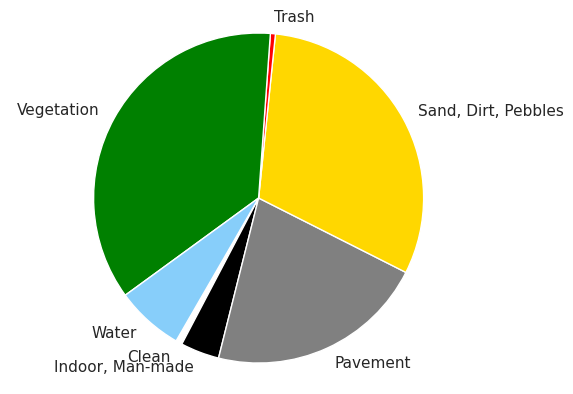

In [7]:
# Get scene cat names
scene_cats = dataset['scene_categories']
scene_name = []
for scene_cat in scene_cats:
    scene_name.append(scene_cat['name'])

nr_scenes = len(scene_cats)
scene_cat_histogram = np.zeros(nr_scenes,dtype=int)

for scene_ann in dataset['scene_annotations']:    
    scene_ann_ids = scene_ann['background_ids']
    for scene_ann_id in scene_ann_ids:
        if scene_ann_id<len(scene_cats):
            scene_cat_histogram[scene_ann_id]+=1

# Convert to DataFrame
df = pd.DataFrame({'scene_cats': scene_cats, 'nr_annotations': scene_cat_histogram})
 
# Plot
colors = ['white','black','gray', 'gold', 'red','green','lightskyblue']
plt.pie(scene_cat_histogram, labels=scene_name, colors = colors,
      shadow=False, startangle=-120)
 
plt.axis('equal')
plt.show()

## 2. Visualize dataset graph

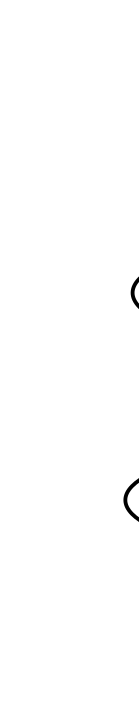

In [8]:
from graphviz import Digraph
# Note: graphviz may require more than pip installation due to path issue: e.g. brew install graphviz for mac

#g = Digraph('G', filename='hello.gv')
dot = Digraph('Dataset graph', filename='asd.gv')
dot.attr(rankdir='LR', size='8,10')

for cat_it in categories:
    dot.node(cat_it['name'])
    if cat_it['name']==cat_it['supercategory']:
        dot.node(cat_it['supercategory'])
    else:
        dot.edge(cat_it['supercategory'], cat_it['name'])
dot
# Uncomment next line to print pdf
#dot.view()

## 3. Visualize Annotated Images

For simplicity, to select and show the dataset images with the respective masks, we make use of the COCO API.
The script below shows how to load and visualize an image with all its annotations.

Unfortunately, several python libraries do not take into account the EXIF orientation tag, thus we have to explicitly rotate the images. Alternatively you can use instead OpenCV.

loading annotations into memory...
Done (t=0.06s)
creating index...
index created!
batch_11/000028.jpg


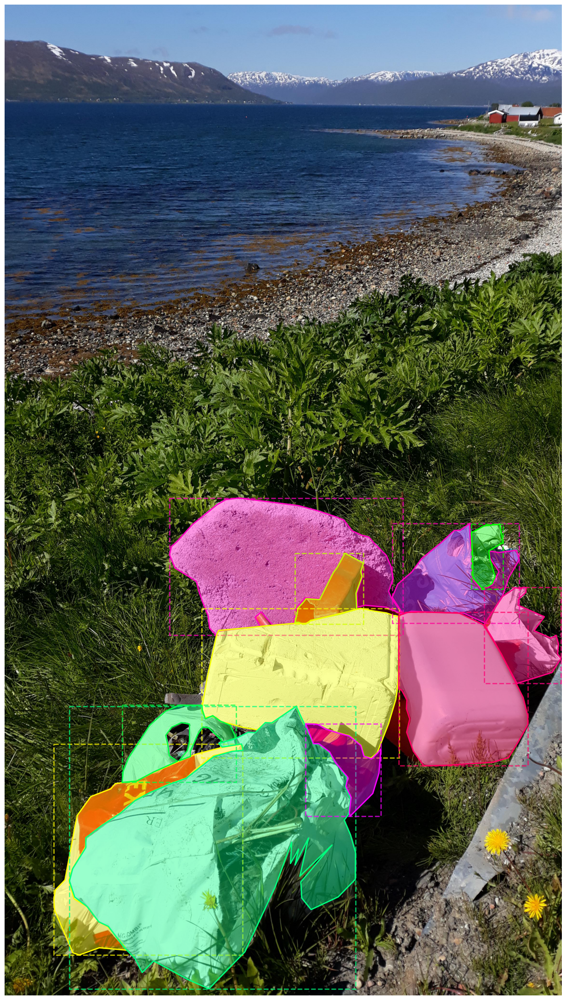

In [7]:
from PIL import Image, ExifTags
from pycocotools.coco import COCO
from matplotlib.patches import Polygon, Rectangle
from matplotlib.collections import PatchCollection
import colorsys
import random
import pylab

# User settings
image_filepath = 'batch_11/000028.jpg'
pylab.rcParams['figure.figsize'] = (28,28)
####################

# Obtain Exif orientation tag code
for orientation in ExifTags.TAGS.keys():
    if ExifTags.TAGS[orientation] == 'Orientation':
        break

# Loads dataset as a coco object
coco = COCO(anns_file_path)

# Find image id
img_id = -1
for img in imgs:
    if img['file_name'] == image_filepath:
        img_id = img['id']
        break

# Show image and corresponding annotations
if img_id == -1:
    print('Incorrect file name')
else:

    # Load image
    print(image_filepath)
    I = Image.open(dataset_path + '/' + image_filepath)

    # Load and process image metadata
    if I._getexif():
        exif = dict(I._getexif().items())
        # Rotate portrait and upside down images if necessary
        if orientation in exif:
            if exif[orientation] == 3:
                I = I.rotate(180,expand=True)
            if exif[orientation] == 6:
                I = I.rotate(270,expand=True)
            if exif[orientation] == 8:
                I = I.rotate(90,expand=True)

    # Show image
    fig,ax = plt.subplots(1)
    plt.axis('off')
    plt.imshow(I)

    # Load mask ids
    annIds = coco.getAnnIds(imgIds=img_id, catIds=[], iscrowd=None)
    anns_sel = coco.loadAnns(annIds)

    # Show annotations
    for ann in anns_sel:
        color = colorsys.hsv_to_rgb(np.random.random(),1,1)
        for seg in ann['segmentation']:
            poly = Polygon(np.array(seg).reshape((int(len(seg)/2), 2)))
            p = PatchCollection([poly], facecolor=color, edgecolors=color,linewidths=0, alpha=0.4)
            ax.add_collection(p)
            p = PatchCollection([poly], facecolor='none', edgecolors=color, linewidths=2)
            ax.add_collection(p)
        [x, y, w, h] = ann['bbox']
        rect = Rectangle((x,y),w,h,linewidth=2,edgecolor=color,
                         facecolor='none', alpha=0.7, linestyle = '--')
        ax.add_patch(rect)

    plt.show()



The script below shows how to filter images by either category or supercategory.

Go ahead and try different (super)categories searches by changing the `category_name`.
Note that small objects may be hard to see.

loading annotations into memory...
Done (t=0.13s)
creating index...
index created!
Number of images found:  227


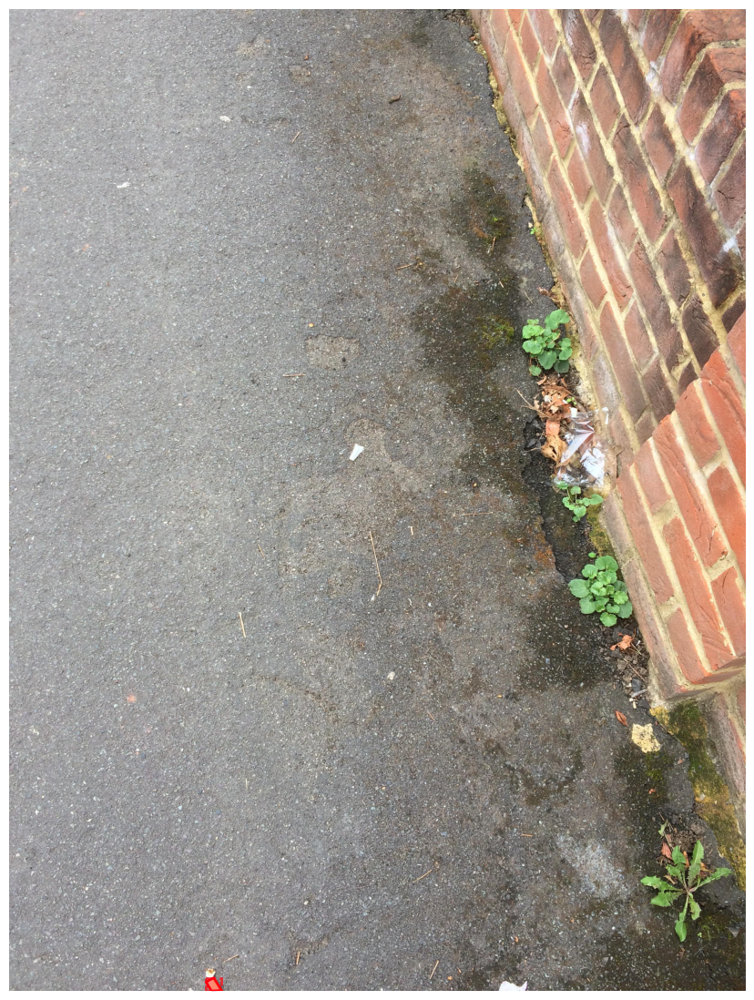

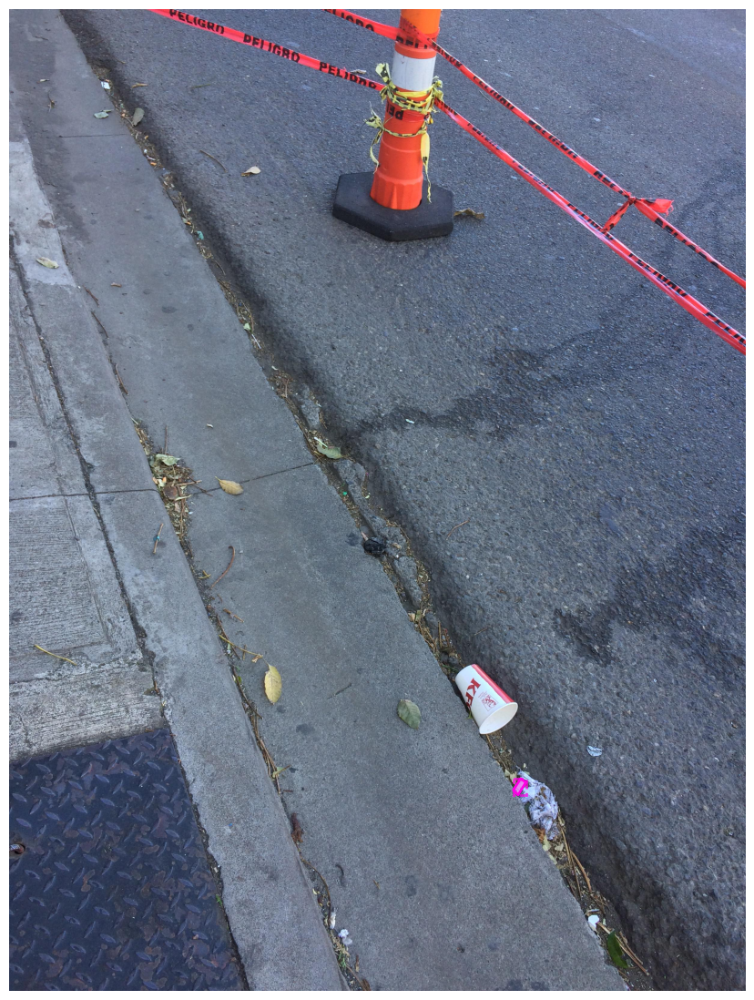

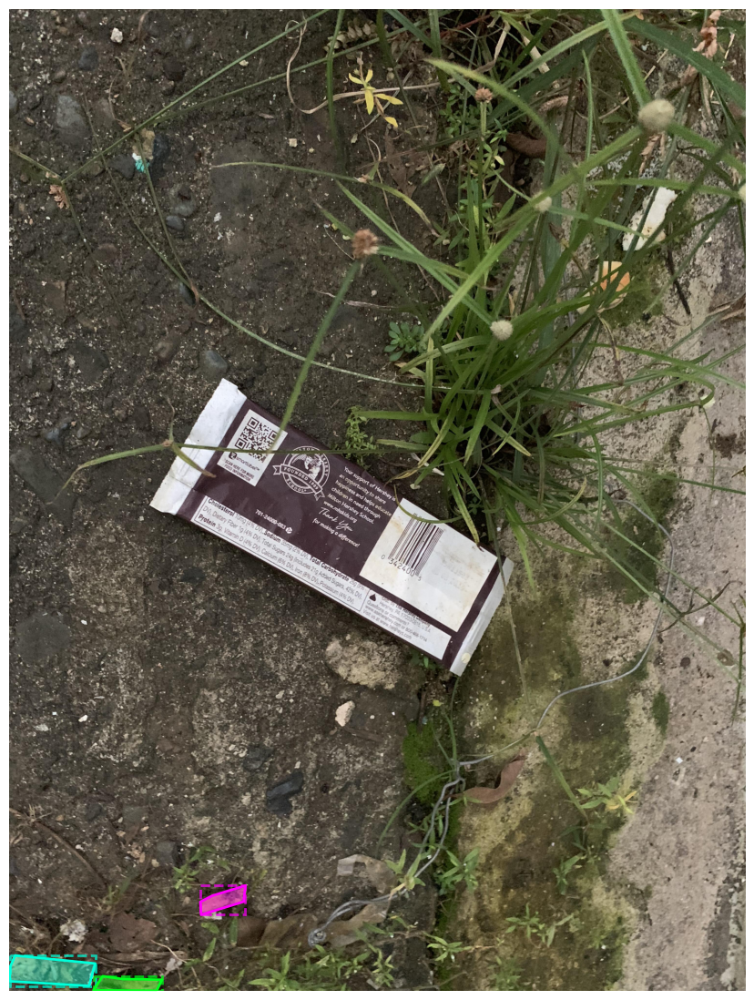

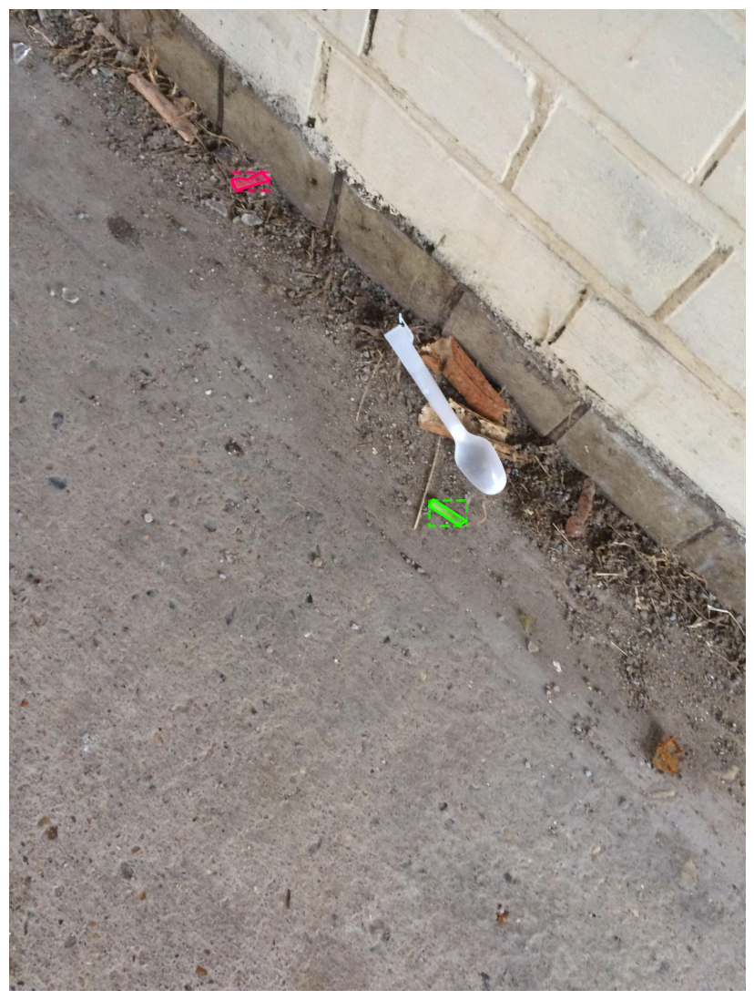

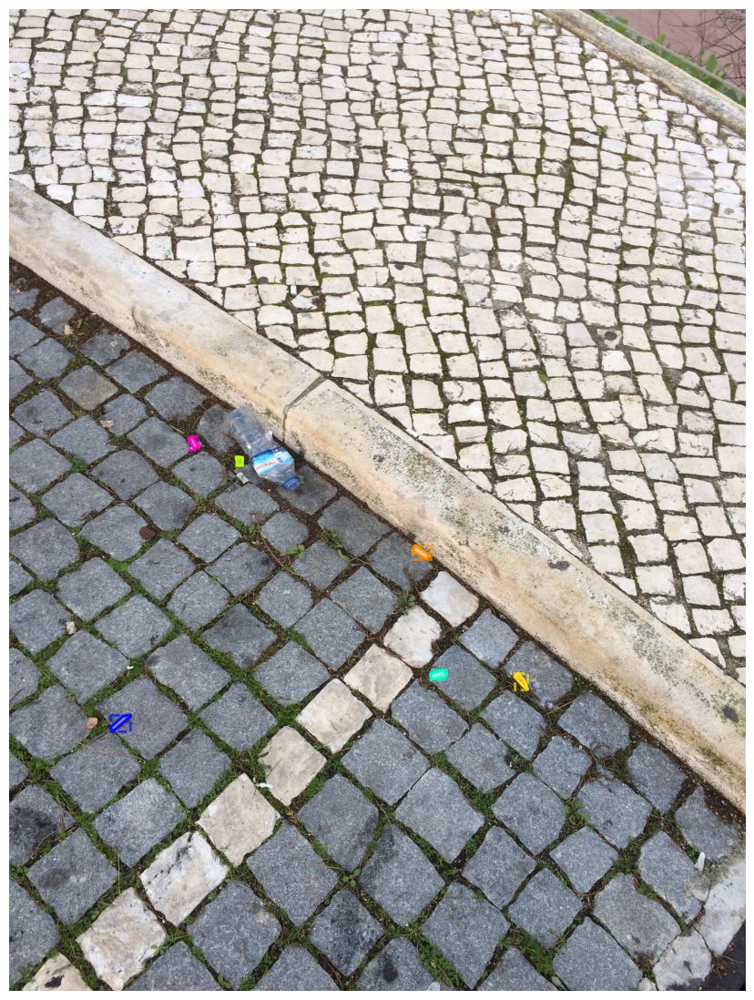

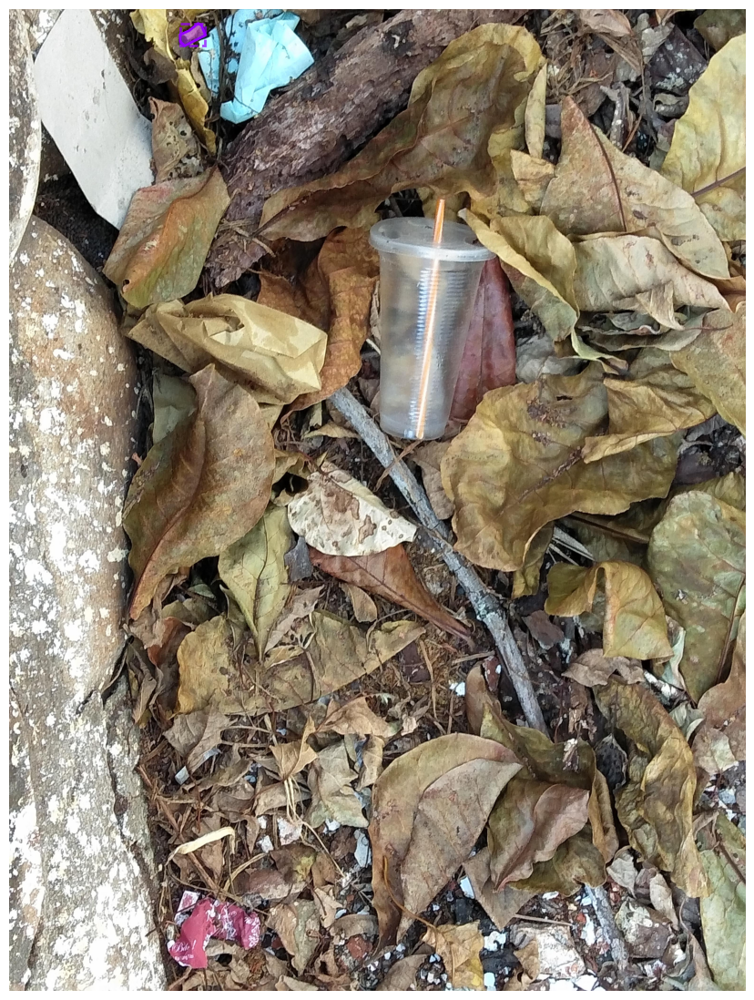

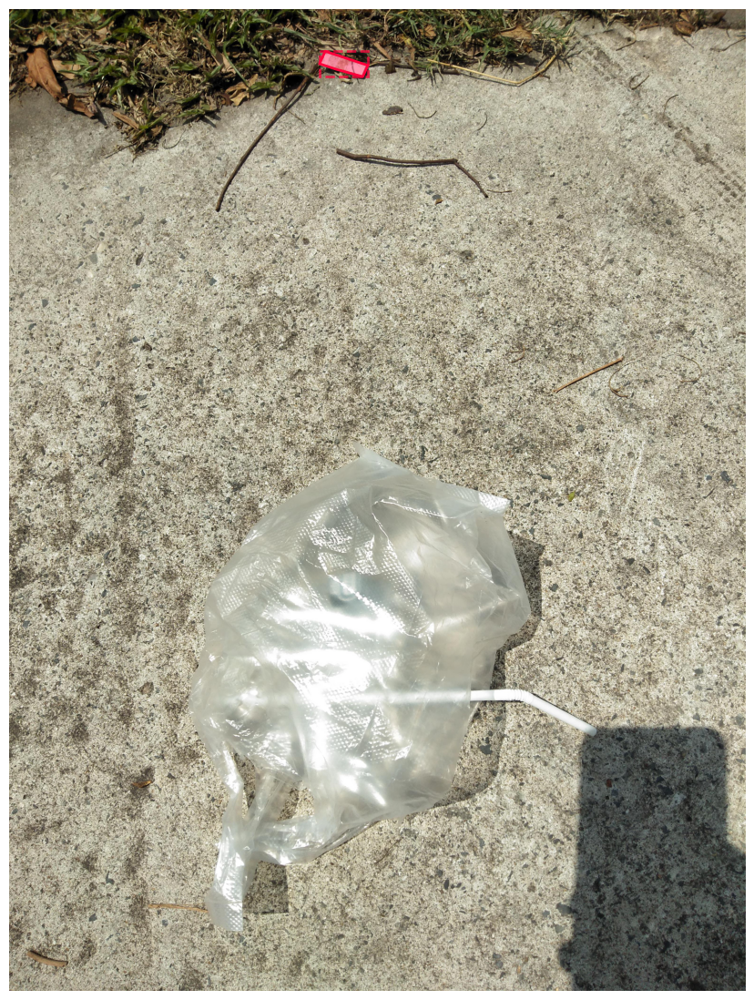

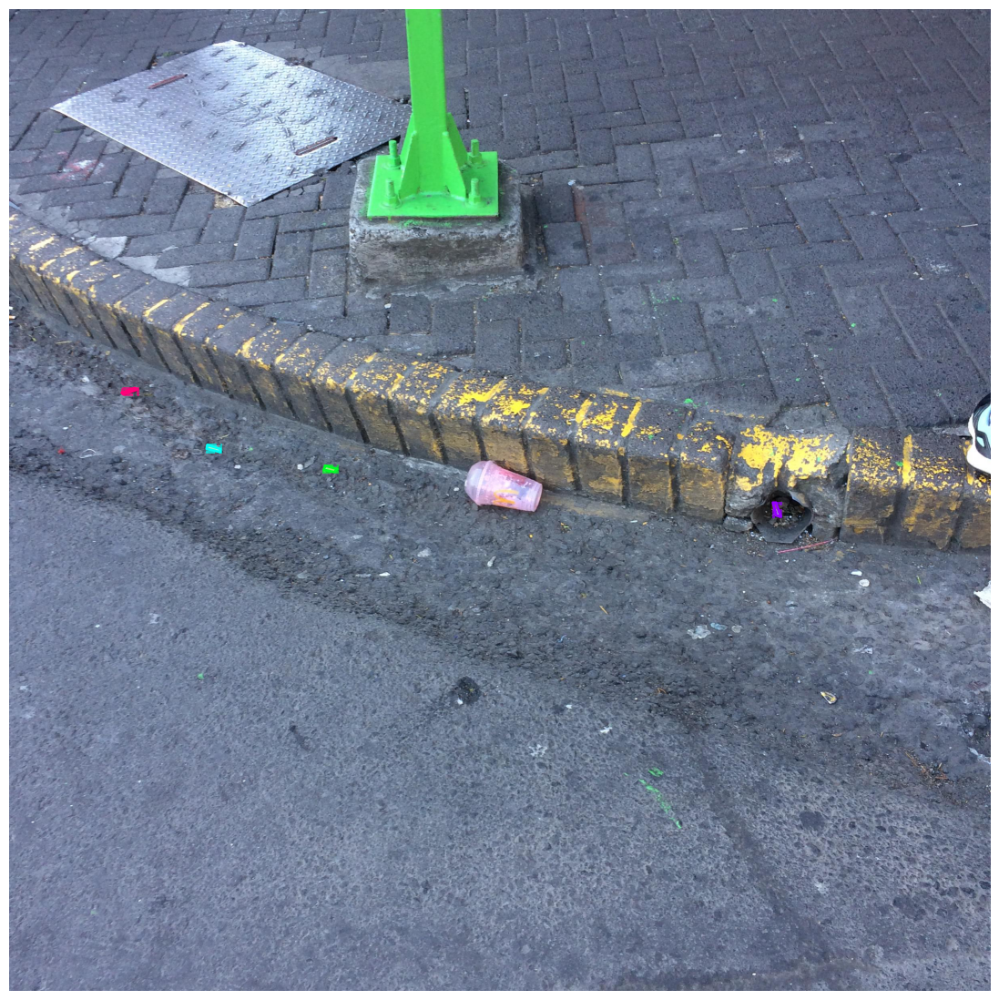

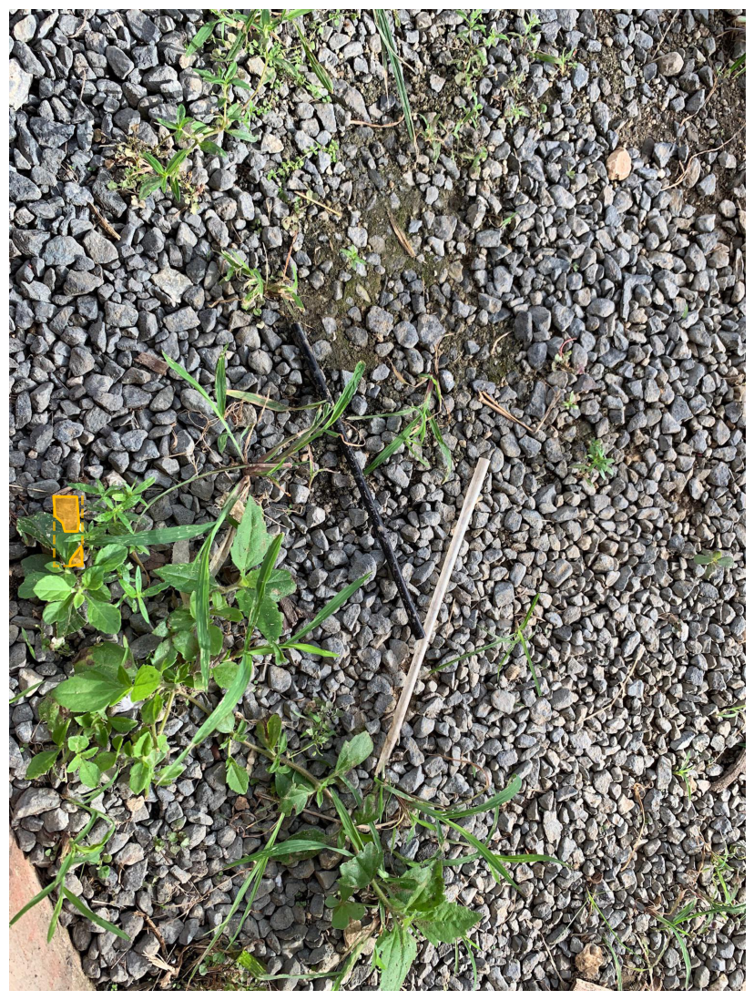

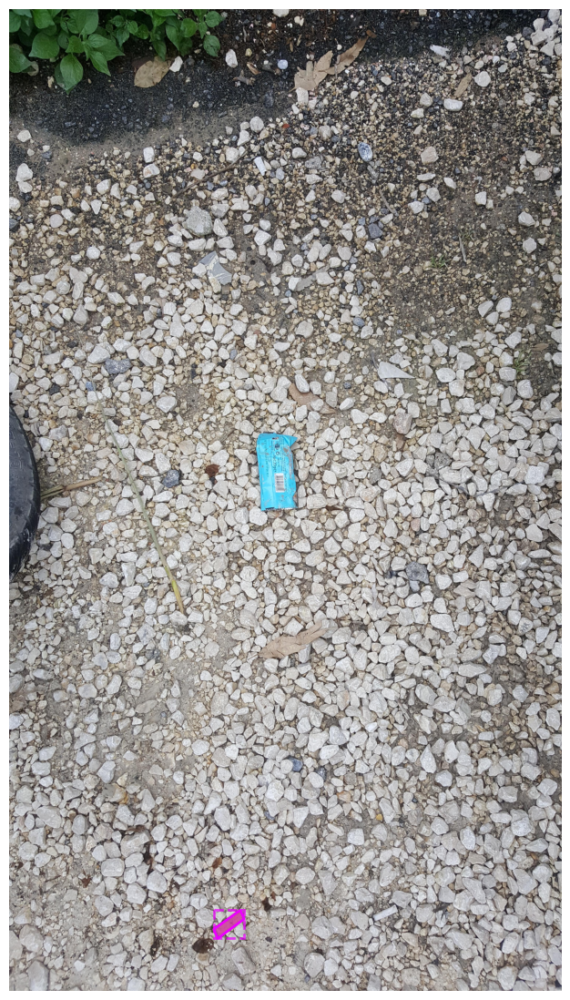

In [10]:
from PIL import Image, ExifTags
from pycocotools.coco import COCO
from matplotlib.patches import Polygon, Rectangle
from matplotlib.collections import PatchCollection
import colorsys
import random
import pylab

# User settings
nr_img_2_display = 10
category_name = 'Cigarette'#  --- Insert the name of one of the categories or super-categories above
pylab.rcParams['figure.figsize'] = (14,14)
####################

# Obtain Exif orientation tag code
for orientation in ExifTags.TAGS.keys():
    if ExifTags.TAGS[orientation] == 'Orientation':
        break

# Loads dataset as a coco object
coco = COCO(anns_file_path)

# Get image ids
imgIds = []
catIds = coco.getCatIds(catNms=[category_name])
if catIds:
    # Get all images containing an instance of the chosen category
    imgIds = coco.getImgIds(catIds=catIds)
else:
    # Get all images containing an instance of the chosen super category
    catIds = coco.getCatIds(supNms=[category_name])
    for catId in catIds:
        imgIds += (coco.getImgIds(catIds=catId))
    imgIds = list(set(imgIds))

nr_images_found = len(imgIds) 
print('Number of images found: ',nr_images_found)

# Select N random images
random.shuffle(imgIds)
imgs = coco.loadImgs(imgIds[0:min(nr_img_2_display,nr_images_found)])

for img in imgs:
    image_path = dataset_path + '/' + img['file_name']
    # Load image
    I = Image.open(image_path)
    
    # Load and process image metadata
    if I._getexif():
        exif = dict(I._getexif().items())
        # Rotate portrait and upside down images if necessary
        if orientation in exif:
            if exif[orientation] == 3:
                I = I.rotate(180,expand=True)
            if exif[orientation] == 6:
                I = I.rotate(270,expand=True)
            if exif[orientation] == 8:
                I = I.rotate(90,expand=True)
    
    # Show image
    fig,ax = plt.subplots(1)
    plt.axis('off')
    plt.imshow(I)

    # Load mask ids
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns_sel = coco.loadAnns(annIds)
    
    # Show annotations
    for ann in anns_sel:
        color = colorsys.hsv_to_rgb(np.random.random(),1,1)
        for seg in ann['segmentation']:
            poly = Polygon(np.array(seg).reshape((int(len(seg)/2), 2)))
            p = PatchCollection([poly], facecolor=color, edgecolors=color,linewidths=0, alpha=0.4)
            ax.add_collection(p)
            p = PatchCollection([poly], facecolor='none', edgecolors=color, linewidths=2)
            ax.add_collection(p)
        [x, y, w, h] = ann['bbox']
        rect = Rectangle((x,y),w,h,linewidth=2,edgecolor=color,
                         facecolor='none', alpha=0.7, linestyle = '--')
        ax.add_patch(rect)

    plt.show()


In [17]:
from mmseg.apis import inference_segmentor, init_segmentor, show_result_pyplot
from mmseg.core.evaluation import get_palette

In [40]:
import os.path as osp
import numpy as np 
from PIL import Image 
# Set up paths 
data_root = 'data'
img_dir = 'images'
ann_dir = 'labels'

classes = ('sky')

In [41]:
from pathlib import Path
import logging


# Object oriented path https://docs.python.org/3/library/pathlib.html

def coco_to_mmsegmentation(
    annotations_file: str, output_annotations_file: str, output_masks_dir: str, logger
):
    """Convert json in [segmentation format](https://gradiant.github.io/ai-dataset-template/supported_tasks/#segmentation) to txt in [mmsegmentation format](https://mmsegmentation.readthedocs.io/en/latest/tutorials/new_dataset.html#reorganize-dataset-to-existing-format).

    Args:
        annotations_file:
            path to json in [segmentation format](https://gradiant.github.io/ai-dataset-template/supported_tasks/#segmentation)
        output_annotations_file:
            path to write the txt in [mmsegmentation format](https://mmsegmentation.readthedocs.io/en/latest/tutorials/customize_datasets.html#customize-datasets-by-reorganizing-data)
        output_masks_dir:
            path where the masks generated from the annotations will be saved to.
            A single `{file_name}.png` mask will be generated for each image.
    """
    import cv2
    import numpy as np
    from pycocotools.coco import COCO

    Path(output_annotations_file).parent.mkdir(parents=True, exist_ok=True)
    Path(output_masks_dir).mkdir(parents=True, exist_ok=True)

    logger.info(f"Loading annotations from {annotations_file}")
    annotations = json.load(open(annotations_file))

    logger.info(f"Saving annotations to {output_annotations_file}")
    with open(output_annotations_file, "w") as f:
        for image in annotations["images"]:
            filename = Path(image["file_name"]).parent / Path(image["file_name"]).stem
            f.write(str(filename))
            f.write("\n")

    logger.info(f"Saving masks to {output_masks_dir}")
    coco_annotations = COCO(annotations_file)
    for image_id, image_data in coco_annotations.imgs.items():
        filename = image_data["file_name"]

        anns_ids = coco_annotations.getAnnIds(imgIds=image_id)
        image_annotations = coco_annotations.loadAnns(anns_ids)

        logger.info(f"Creating output mask for {filename}")

        output_mask = np.zeros(
            (image_data["height"], image_data["width"]), dtype=np.uint8
        )
        for image_annotation in image_annotations:
            category_id = image_annotation["category_id"]
            try:
                category_mask = coco_annotations.annToMask(image_annotation)
            except Exception as e:
                logger.warning(e)
                logger.warning(f"Skipping {image_annotation}")
                continue
            try:
                category_mask *= category_id
                category_mask *= output_mask == 0
                output_mask += category_mask
            except Exception as e: 
                print(e)

        output_filename = Path(output_masks_dir) / Path(filename).with_suffix(".png")
        output_filename.parent.mkdir(parents=True, exist_ok=True)

        logger.info(f"Writting mask to {output_filename}")
        cv2.imwrite(str(output_filename), output_mask)

## 2. Transform COCO segmentation to mmsegmentation format 

In [45]:
root_dir = "/home/zozan-server/Work/FER/TACO"
annot_in = osp.join(root_dir, "data/new_annotations.json")
annot_out = osp.join(root_dir, "data_transformed/annotations.txt")
annot_folder = osp.join(root_dir, "data_transformed/annotated_imgs")
# Define logger
logger = logging.getLogger()
logger.setLevel(logging.DEBUG)
logging.debug("test")
# Transformed COCO to mmsegmentation 
coco_to_mmsegmentation(annot_in, annot_out, annot_folder, logger) 

DEBUG:root:test
INFO:root:Loading annotations from /home/zozan-server/Work/FER/TACO/data/new_annotations.json
INFO:root:Saving annotations to /home/zozan-server/Work/FER/TACO/data_transformed/annotations.txt
INFO:root:Saving masks to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs
INFO:root:Creating output mask for batch_1/000006.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000006.png


loading annotations into memory...
Done (t=0.17s)
creating index...
index created!


INFO:root:Creating output mask for batch_1/000008.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000008.png
INFO:root:Creating output mask for batch_1/000010.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000010.png
INFO:root:Creating output mask for batch_1/000019.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000019.png
INFO:root:Creating output mask for batch_1/000026.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000026.png
INFO:root:Creating output mask for batch_1/000047.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000047.png
INFO:root:Creating output mask for batch_1/000055.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000055.png
INFO:root:

INFO:root:Creating output mask for batch_1/000069.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000069.png
INFO:root:Creating output mask for batch_1/000070.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000070.png
INFO:root:Creating output mask for batch_1/000071.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000071.png
INFO:root:Creating output mask for batch_1/000072.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000072.png
INFO:root:Creating output mask for batch_1/000073.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000073.png
INFO:root:Creating output mask for batch_1/000074.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000074.png
INFO:root:

operands could not be broadcast together with shapes (4000,1824) (3264,2448) (4000,1824) 


INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000122.png
INFO:root:Creating output mask for batch_1/000004.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000004.png
INFO:root:Creating output mask for batch_1/000124.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000124.png
INFO:root:Creating output mask for batch_1/000127.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000127.png
INFO:root:Creating output mask for batch_1/000128.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000128.png
INFO:root:Creating output mask for batch_1/000129.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000129.png
INFO:root:Creating output mask for batch_10/000000.jpg
INFO:root

INFO:root:Creating output mask for batch_10/000044.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000044.png
INFO:root:Creating output mask for batch_10/000045.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000045.png
INFO:root:Creating output mask for batch_10/000046.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000046.png
INFO:root:Creating output mask for batch_10/000047.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000047.png
INFO:root:Creating output mask for batch_10/000048.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000048.png
INFO:root:Creating output mask for batch_10/000049.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000049.pn

INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000093.png
INFO:root:Creating output mask for batch_10/000094.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000094.png
INFO:root:Creating output mask for batch_10/000095.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000095.png
INFO:root:Creating output mask for batch_10/000096.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000096.png
INFO:root:Creating output mask for batch_10/000097.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000097.png
INFO:root:Creating output mask for batch_10/000098.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000098.png
INFO:root:Creating output mask for batch_10/000099.jp

INFO:root:Creating output mask for batch_11/000043.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000043.png
INFO:root:Creating output mask for batch_11/000044.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000044.png
INFO:root:Creating output mask for batch_11/000045.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000045.png
INFO:root:Creating output mask for batch_11/000046.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000046.png
INFO:root:Creating output mask for batch_11/000047.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000047.png
INFO:root:Creating output mask for batch_11/000048.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000048.pn

INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000092.png
INFO:root:Creating output mask for batch_11/000093.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000093.png
INFO:root:Creating output mask for batch_11/000094.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000094.png
INFO:root:Creating output mask for batch_11/000095.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000095.png
INFO:root:Creating output mask for batch_11/000096.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000096.png
INFO:root:Creating output mask for batch_11/000097.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000097.png
INFO:root:Creating output mask for batch_11/000098.jp

INFO:root:Creating output mask for batch_12/000042.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000042.png
INFO:root:Creating output mask for batch_12/000043.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000043.png
INFO:root:Creating output mask for batch_12/000044.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000044.png
INFO:root:Creating output mask for batch_12/000045.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000045.png
INFO:root:Creating output mask for batch_12/000046.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000046.png
INFO:root:Creating output mask for batch_12/000047.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000047.pn

INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000091.png
INFO:root:Creating output mask for batch_12/000092.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000092.png
INFO:root:Creating output mask for batch_12/000093.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000093.png
INFO:root:Creating output mask for batch_12/000094.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000094.png
INFO:root:Creating output mask for batch_12/000095.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000095.png
INFO:root:Creating output mask for batch_12/000096.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000096.png
INFO:root:Creating output mask for batch_12/000097.jp

INFO:root:Creating output mask for batch_13/000041.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000041.png
INFO:root:Creating output mask for batch_13/000042.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000042.png
INFO:root:Creating output mask for batch_13/000043.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000043.png
INFO:root:Creating output mask for batch_13/000044.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000044.png
INFO:root:Creating output mask for batch_13/000045.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000045.png
INFO:root:Creating output mask for batch_13/000046.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000046.pn

INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000090.png
INFO:root:Creating output mask for batch_13/000091.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000091.png
INFO:root:Creating output mask for batch_13/000092.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000092.png
INFO:root:Creating output mask for batch_13/000093.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000093.png
INFO:root:Creating output mask for batch_13/000094.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000094.png
INFO:root:Creating output mask for batch_13/000095.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000095.png
INFO:root:Creating output mask for batch_13/000096.jp

INFO:root:Creating output mask for batch_14/000040.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000040.png
INFO:root:Creating output mask for batch_14/000041.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000041.png
INFO:root:Creating output mask for batch_14/000042.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000042.png
INFO:root:Creating output mask for batch_14/000043.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000043.png
INFO:root:Creating output mask for batch_14/000044.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000044.png
INFO:root:Creating output mask for batch_14/000045.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000045.pn

INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000089.png
INFO:root:Creating output mask for batch_14/000090.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000090.png
INFO:root:Creating output mask for batch_14/000091.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000091.png
INFO:root:Creating output mask for batch_14/000092.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000092.png
INFO:root:Creating output mask for batch_14/000093.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000093.png
INFO:root:Creating output mask for batch_14/000094.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000094.png
INFO:root:Creating output mask for batch_14/000095.jp

INFO:root:Creating output mask for batch_15/000039.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000039.png
INFO:root:Creating output mask for batch_15/000040.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000040.png
INFO:root:Creating output mask for batch_15/000041.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000041.png
INFO:root:Creating output mask for batch_15/000042.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000042.png
INFO:root:Creating output mask for batch_15/000043.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000043.png
INFO:root:Creating output mask for batch_15/000044.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000044.pn

INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000005.png
INFO:root:Creating output mask for batch_2/000006.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000006.png
INFO:root:Creating output mask for batch_2/000007.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000007.png
INFO:root:Creating output mask for batch_2/000008.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000008.png
INFO:root:Creating output mask for batch_2/000009.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000009.png
INFO:root:Creating output mask for batch_2/000010.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000010.png
INFO:root:Creating output mask for batch_2/000012.JPG
INFO:root:

INFO:root:Creating output mask for batch_2/000061.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000061.png
INFO:root:Creating output mask for batch_2/000062.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000062.png
INFO:root:Creating output mask for batch_2/000063.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000063.png
INFO:root:Creating output mask for batch_2/000064.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000064.png
INFO:root:Creating output mask for batch_2/000065.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000065.png
INFO:root:Creating output mask for batch_2/000067.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000067.png
INFO:root:

INFO:root:Creating output mask for batch_3/IMG_5036.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_5036.png
INFO:root:Creating output mask for batch_3/IMG_5039.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_5039.png
INFO:root:Creating output mask for batch_3/IMG_5040.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_5040.png
INFO:root:Creating output mask for batch_3/IMG_5041.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_5041.png
INFO:root:Creating output mask for batch_3/IMG_5042.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_5042.png
INFO:root:Creating output mask for batch_3/IMG_5043.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3

INFO:root:Creating output mask for batch_3/IMG_4913.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_4913.png
INFO:root:Creating output mask for batch_3/IMG_4914.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_4914.png
INFO:root:Creating output mask for batch_3/IMG_4915.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_4915.png
INFO:root:Creating output mask for batch_3/IMG_4916.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_4916.png
INFO:root:Creating output mask for batch_3/IMG_4917.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_4917.png
INFO:root:Creating output mask for batch_3/IMG_4919.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3

INFO:root:Creating output mask for batch_4/000010.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000010.png
INFO:root:Creating output mask for batch_4/000011.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000011.png
INFO:root:Creating output mask for batch_4/000012.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000012.png
INFO:root:Creating output mask for batch_4/000013.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000013.png
INFO:root:Creating output mask for batch_4/000014.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000014.png
INFO:root:Creating output mask for batch_4/000015.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000015.png
INFO:root:

INFO:root:Creating output mask for batch_4/000069.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000069.png
INFO:root:Creating output mask for batch_4/000070.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000070.png
INFO:root:Creating output mask for batch_4/000071.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000071.png
INFO:root:Creating output mask for batch_4/000072.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000072.png
INFO:root:Creating output mask for batch_4/000073.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000073.png
INFO:root:Creating output mask for batch_4/000074.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000074.png
INFO:root:

INFO:root:Creating output mask for batch_5/000096.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000096.png
INFO:root:Creating output mask for batch_5/000097.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000097.png
INFO:root:Creating output mask for batch_5/000098.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000098.png
INFO:root:Creating output mask for batch_5/000099.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000099.png
INFO:root:Creating output mask for batch_5/000100.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000100.png
INFO:root:Creating output mask for batch_5/000062.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000062.png
INFO:root:

INFO:root:Creating output mask for batch_5/000020.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000020.png
INFO:root:Creating output mask for batch_5/000021.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000021.png
INFO:root:Creating output mask for batch_5/000022.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000022.png
INFO:root:Creating output mask for batch_5/000023.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000023.png
INFO:root:Creating output mask for batch_5/000024.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000024.png
INFO:root:Creating output mask for batch_5/000025.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000025.png
INFO:root:

INFO:root:Creating output mask for batch_6/000094.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000094.png
INFO:root:Creating output mask for batch_6/000093.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000093.png
INFO:root:Creating output mask for batch_6/000092.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000092.png
INFO:root:Creating output mask for batch_6/000091.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000091.png
INFO:root:Creating output mask for batch_6/000090.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000090.png
INFO:root:Creating output mask for batch_6/000089.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000089.png
INFO:root:

INFO:root:Creating output mask for batch_6/000040.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000040.png
INFO:root:Creating output mask for batch_6/000039.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000039.png
INFO:root:Creating output mask for batch_6/000038.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000038.png
INFO:root:Creating output mask for batch_6/000037.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000037.png
INFO:root:Creating output mask for batch_6/000036.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000036.png
INFO:root:Creating output mask for batch_6/000035.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000035.png
INFO:root:

INFO:root:Creating output mask for batch_7/000016.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000016.png
INFO:root:Creating output mask for batch_7/000017.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000017.png
INFO:root:Creating output mask for batch_7/000018.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000018.png
INFO:root:Creating output mask for batch_7/000019.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000019.png
INFO:root:Creating output mask for batch_7/000020.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000020.png
INFO:root:Creating output mask for batch_7/000021.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000021.png
INFO:root:

INFO:root:Creating output mask for batch_7/000076.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000076.png
INFO:root:Creating output mask for batch_7/000077.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000077.png
INFO:root:Creating output mask for batch_7/000078.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000078.png
INFO:root:Creating output mask for batch_7/000079.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000079.png
INFO:root:Creating output mask for batch_7/000080.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000080.png
INFO:root:Creating output mask for batch_7/000081.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000081.png
INFO:root:

INFO:root:Creating output mask for batch_7/000129.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000129.png
INFO:root:Creating output mask for batch_7/000131.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000131.png
INFO:root:Creating output mask for batch_7/000132.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000132.png
INFO:root:Creating output mask for batch_7/000133.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000133.png
INFO:root:Creating output mask for batch_7/000134.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000134.png
INFO:root:Creating output mask for batch_7/000135.JPG
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000135.png
INFO:root:

INFO:root:Creating output mask for batch_8/000037.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000037.png
INFO:root:Creating output mask for batch_8/000038.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000038.png
INFO:root:Creating output mask for batch_8/000039.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000039.png
INFO:root:Creating output mask for batch_8/000040.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000040.png
INFO:root:Creating output mask for batch_8/000041.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000041.png
INFO:root:Creating output mask for batch_8/000042.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000042.png
INFO:root:

INFO:root:Creating output mask for batch_8/000087.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000087.png
INFO:root:Creating output mask for batch_8/000088.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000088.png
INFO:root:Creating output mask for batch_8/000089.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000089.png
INFO:root:Creating output mask for batch_8/000090.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000090.png
INFO:root:Creating output mask for batch_8/000091.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000091.png
INFO:root:Creating output mask for batch_8/000092.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000092.png
INFO:root:

INFO:root:Creating output mask for batch_9/000037.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000037.png
INFO:root:Creating output mask for batch_9/000038.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000038.png
INFO:root:Creating output mask for batch_9/000039.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000039.png
INFO:root:Creating output mask for batch_9/000040.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000040.png
INFO:root:Creating output mask for batch_9/000041.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000041.png
INFO:root:Creating output mask for batch_9/000042.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000042.png
INFO:root:

INFO:root:Creating output mask for batch_9/000087.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000087.png
INFO:root:Creating output mask for batch_9/000088.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000088.png
INFO:root:Creating output mask for batch_9/000089.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000089.png
INFO:root:Creating output mask for batch_9/000090.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000090.png
INFO:root:Creating output mask for batch_9/000091.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000091.png
INFO:root:Creating output mask for batch_9/000092.jpg
INFO:root:Writting mask to /home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000092.png
INFO:root:

In [46]:
import os
import shutil
import glob
import os.path as osp

def copy_images(folder_path, destination_path):
    # Create the destination folder if it doesn't exist
    if not os.path.exists(destination_path):
        os.makedirs(destination_path)

    image_files = glob.glob(os.path.join(folder_path, '**', '.JPG'), recursive=True)  # Change the file extension if necessary
    print(image_files)
    for i, image_file in enumerate(image_files):
        new_filename = f"image_{i}.jpg"  # Change the filename pattern if necessary
        new_filepath = os.path.join(destination_path, new_filename)
        shutil.copy(image_file, new_filepath)
        print(f"Copied {image_file} to {new_filepath}")

# Example usage:
folder_path = '/home/zozan-server/Work/FER/TACO/data/'
destination_path = '/home/zozan-server/Work/FER/TACO/data_transformed/images'

copy_images(folder_path, destination_path)

[]


In [47]:
root_dir = "/home/zozan-server/Work/FER/TACO"
img_dir = osp.join(root_dir, 'data/')
ann_dir = osp.join(root_dir, 'data_transformed/annotated_imgs/')
new_img_dir = osp.join(root_dir, 'data_transformed/images')
new_ann_dir = osp.join(root_dir, 'data_transformed/annotations')

## 3. Move images from batch folders 

In [72]:

subfolders = []
for i in os.listdir(img_dir): 
    subfolders.append(i)
    
cnt = 0
for folder in subfolders: 
    img_path = osp.join(img_dir, folder)
    annot_path = osp.join(ann_dir, folder)
    if 'batch' in img_path: 
        for i in os.listdir(img_path): 
            img_num, img_ext = osp.splitext(i)
            full_img_path_ = osp.join(img_path, i)
            annot = "{}.{}".format(img_num, "png")
            full_annot_path_ = osp.join(annot_path, annot)
            cnt += 1
            copy_and_rename_file(full_img_path_, new_img_dir, cnt)
            copy_and_rename_file(full_annot_path_, new_ann_dir, cnt)
            
            

File '/home/zozan-server/Work/FER/TACO/data/batch_5/000101.JPG' copied and renamed to '000001.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000101.png' copied and renamed to '000001.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_5/000024.JPG' copied and renamed to '000002.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000024.png' copied and renamed to '000002.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_5/000054.JPG' copied and renamed to '000003.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000054.png' copied and renamed to '000003.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_5/000086.JPG' copied and renamed to '000051.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000086.png' copied and renamed to '000051.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_5/000031.JPG' copied and renamed to '000052.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000031.png' copied and renamed to '000052.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_5/000094.JPG' copied and renamed to '000053.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000094.png' copied and renamed to '000053.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_5/000015.JPG' copied and renamed to '000092.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000015.png' copied and renamed to '000092.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_5/000090.JPG' copied and renamed to '000093.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000090.png' copied and renamed to '000093.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_5/000069.JPG' copied and renamed to '000094.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_5/000069.png' copied and renamed to '000094.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_13/000003.jpg' copied and renamed to '000125.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000003.png' copied and renamed to '000125.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_13/000091.jpg' copied and renamed to '000126.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000091.png' copied and renamed to '000126.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_13/000080.jpg' copied and renamed to '000127.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000080.png' copied and renamed to '000127

File '/home/zozan-server/Work/FER/TACO/data/batch_13/000029.jpg' copied and renamed to '000161.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000029.png' copied and renamed to '000161.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_13/000078.jpg' copied and renamed to '000162.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000078.png' copied and renamed to '000162.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_13/000076.jpg' copied and renamed to '000163.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000076.png' copied and renamed to '000163

File '/home/zozan-server/Work/FER/TACO/data/batch_13/000020.jpg' copied and renamed to '000196.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000020.png' copied and renamed to '000196.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_13/000022.jpg' copied and renamed to '000197.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000022.png' copied and renamed to '000197.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_13/000008.jpg' copied and renamed to '000198.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_13/000008.png' copied and renamed to '000198

File '/home/zozan-server/Work/FER/TACO/data/batch_10/000065.jpg' copied and renamed to '000240.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000065.png' copied and renamed to '000240.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_10/000002.jpg' copied and renamed to '000241.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000002.png' copied and renamed to '000241.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_10/000047.jpg' copied and renamed to '000242.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000047.png' copied and renamed to '000242

File '/home/zozan-server/Work/FER/TACO/data/batch_10/000050.jpg' copied and renamed to '000276.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000050.png' copied and renamed to '000276.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_10/000000.jpg' copied and renamed to '000277.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000000.png' copied and renamed to '000277.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_10/000057.jpg' copied and renamed to '000278.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000057.png' copied and renamed to '000278

File '/home/zozan-server/Work/FER/TACO/data/batch_10/000059.jpg' copied and renamed to '000303.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000059.png' copied and renamed to '000303.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_10/000006.jpg' copied and renamed to '000304.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000006.png' copied and renamed to '000304.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_10/000030.jpg' copied and renamed to '000305.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_10/000030.png' copied and renamed to '000305

File '/home/zozan-server/Work/FER/TACO/data/batch_4/000021.JPG' copied and renamed to '000332.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000021.png' copied and renamed to '000332.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_4/000042.JPG' copied and renamed to '000333.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000042.png' copied and renamed to '000333.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_4/000053.JPG' copied and renamed to '000334.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000053.png' copied and renamed to '000334.png' 

File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000062.png' copied and renamed to '000364.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_4/000074.JPG' copied and renamed to '000365.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000074.png' copied and renamed to '000365.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_4/000048.JPG' copied and renamed to '000366.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000048.png' copied and renamed to '000366.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_4/000034.JPG' copied and renamed to '000367.

File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000035.png' copied and renamed to '000392.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_4/000058.JPG' copied and renamed to '000393.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000058.png' copied and renamed to '000393.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_4/000007.JPG' copied and renamed to '000394.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_4/000007.png' copied and renamed to '000394.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_4/000047.JPG' copied and renamed to '000395.

File '/home/zozan-server/Work/FER/TACO/data/batch_7/000049.JPG' copied and renamed to '000422.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000049.png' copied and renamed to '000422.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_7/000123.JPG' copied and renamed to '000423.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000123.png' copied and renamed to '000423.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_7/000115.JPG' copied and renamed to '000424.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000115.png' copied and renamed to '000424.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_7/000092.JPG' copied and renamed to '000455.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000092.png' copied and renamed to '000455.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_7/000126.JPG' copied and renamed to '000456.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000126.png' copied and renamed to '000456.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_7/000008.JPG' copied and renamed to '000457.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000008.png' copied and renamed to '000457.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_7/000004.JPG' copied and renamed to '000484.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000004.png' copied and renamed to '000484.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_7/000045.JPG' copied and renamed to '000485.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000045.png' copied and renamed to '000485.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_7/000043.JPG' copied and renamed to '000486.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000043.png' copied and renamed to '000486.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_7/000083.JPG' copied and renamed to '000523.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000083.png' copied and renamed to '000523.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_7/000070.JPG' copied and renamed to '000524.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000070.png' copied and renamed to '000524.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_7/000098.JPG' copied and renamed to '000525.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_7/000098.png' copied and renamed to '000525.png' 

File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_4932.png' copied and renamed to '000547.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_3/IMG_5048.JPG' copied and renamed to '000548.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_5048.png' copied and renamed to '000548.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_3/IMG_4948.JPG' copied and renamed to '000549.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_4948.png' copied and renamed to '000549.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_3/IMG_4869.JPG' copied and renamed

File '/home/zozan-server/Work/FER/TACO/data/batch_3/IMG_4921.JPG' copied and renamed to '000587.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_4921.png' copied and renamed to '000587.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_3/IMG_5060.JPG' copied and renamed to '000588.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_5060.png' copied and renamed to '000588.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_3/IMG_5042.JPG' copied and renamed to '000589.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_3/IMG_5042.png' copied and renamed to '

File '/home/zozan-server/Work/FER/TACO/data/batch_14/000079.jpg' copied and renamed to '000628.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000079.png' copied and renamed to '000628.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_14/000072.jpg' copied and renamed to '000629.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000072.png' copied and renamed to '000629.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_14/000035.jpg' copied and renamed to '000630.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000035.png' copied and renamed to '000630

File '/home/zozan-server/Work/FER/TACO/data/batch_14/000052.jpg' copied and renamed to '000669.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000052.png' copied and renamed to '000669.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_14/000062.jpg' copied and renamed to '000670.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000062.png' copied and renamed to '000670.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_14/000090.jpg' copied and renamed to '000671.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000090.png' copied and renamed to '000671

File '/home/zozan-server/Work/FER/TACO/data/batch_14/000084.jpg' copied and renamed to '000696.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000084.png' copied and renamed to '000696.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_14/000043.jpg' copied and renamed to '000697.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000043.png' copied and renamed to '000697.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_14/000088.jpg' copied and renamed to '000698.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000088.png' copied and renamed to '000698

File '/home/zozan-server/Work/FER/TACO/data/batch_14/000085.jpg' copied and renamed to '000722.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000085.png' copied and renamed to '000722.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_14/000001.jpg' copied and renamed to '000723.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000001.png' copied and renamed to '000723.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_14/000094.jpg' copied and renamed to '000724.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_14/000094.png' copied and renamed to '000724

File '/home/zozan-server/Work/FER/TACO/data/batch_15/000054.jpg' copied and renamed to '000752.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000054.png' copied and renamed to '000752.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_15/000041.jpg' copied and renamed to '000753.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000041.png' copied and renamed to '000753.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_15/000021.jpg' copied and renamed to '000754.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000021.png' copied and renamed to '000754

File '/home/zozan-server/Work/FER/TACO/data/batch_15/000084.jpg' copied and renamed to '000786.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000084.png' copied and renamed to '000786.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_15/000043.jpg' copied and renamed to '000787.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000043.png' copied and renamed to '000787.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_15/000025.jpg' copied and renamed to '000788.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_15/000025.png' copied and renamed to '000788

File '/home/zozan-server/Work/FER/TACO/data/batch_9/000007.jpg' copied and renamed to '000847.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000007.png' copied and renamed to '000847.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_9/000024.jpg' copied and renamed to '000848.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000024.png' copied and renamed to '000848.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_9/000083.jpg' copied and renamed to '000849.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000083.png' copied and renamed to '000849.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_9/000084.jpg' copied and renamed to '000881.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000084.png' copied and renamed to '000881.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_9/000043.jpg' copied and renamed to '000882.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000043.png' copied and renamed to '000882.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_9/000088.jpg' copied and renamed to '000883.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_9/000088.png' copied and renamed to '000883.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_12/000009.jpg' copied and renamed to '000911.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000009.png' copied and renamed to '000911.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_12/000038.jpg' copied and renamed to '000912.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000038.png' copied and renamed to '000912.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_12/000079.jpg' copied and renamed to '000913.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000079.png' copied and renamed to '000913

File '/home/zozan-server/Work/FER/TACO/data/batch_12/000017.jpg' copied and renamed to '000946.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000017.png' copied and renamed to '000946.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_12/000007.jpg' copied and renamed to '000947.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000007.png' copied and renamed to '000947.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_12/000024.jpg' copied and renamed to '000948.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000024.png' copied and renamed to '000948

File '/home/zozan-server/Work/FER/TACO/data/batch_12/000033.jpg' copied and renamed to '000979.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000033.png' copied and renamed to '000979.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_12/000051.jpg' copied and renamed to '000980.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000051.png' copied and renamed to '000980.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_12/000084.jpg' copied and renamed to '000981.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_12/000084.png' copied and renamed to '000981

File '/home/zozan-server/Work/FER/TACO/data/batch_11/000075.jpg' copied and renamed to '001031.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000075.png' copied and renamed to '001031.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_11/000013.jpg' copied and renamed to '001032.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000013.png' copied and renamed to '001032.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_11/000064.jpg' copied and renamed to '001033.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000064.png' copied and renamed to '001033

File '/home/zozan-server/Work/FER/TACO/data/batch_11/000078.jpg' copied and renamed to '001060.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000078.png' copied and renamed to '001060.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_11/000076.jpg' copied and renamed to '001061.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000076.png' copied and renamed to '001061.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_11/000082.jpg' copied and renamed to '001062.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000082.png' copied and renamed to '001062

File '/home/zozan-server/Work/FER/TACO/data/batch_11/000063.jpg' copied and renamed to '001088.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000063.png' copied and renamed to '001088.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_11/000027.jpg' copied and renamed to '001089.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000027.png' copied and renamed to '001089.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_11/000071.jpg' copied and renamed to '001090.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_11/000071.png' copied and renamed to '001090

File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000028.png' copied and renamed to '001163.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_1/000062.JPG' copied and renamed to '001164.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000062.png' copied and renamed to '001164.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_1/000055.jpg' copied and renamed to '001165.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_1/000055.png' copied and renamed to '001165.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_1/000074.JPG' copied and renamed to '001166.

File '/home/zozan-server/Work/FER/TACO/data/batch_2/000076.JPG' copied and renamed to '001215.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000076.png' copied and renamed to '001215.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_2/000072.JPG' copied and renamed to '001216.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000072.png' copied and renamed to '001216.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_2/000040.JPG' copied and renamed to '001217.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000040.png' copied and renamed to '001217.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_2/000034.JPG' copied and renamed to '001269.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000034.png' copied and renamed to '001269.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_2/000039.JPG' copied and renamed to '001270.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000039.png' copied and renamed to '001270.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_2/000036.JPG' copied and renamed to '001271.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000036.png' copied and renamed to '001271.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_2/000051.JPG' copied and renamed to '001303.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_2/000051.png' copied and renamed to '001303.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_8/000009.jpg' copied and renamed to '001304.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000009.png' copied and renamed to '001304.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_8/000038.jpg' copied and renamed to '001305.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000038.png' copied and renamed to '001305.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_8/000028.jpg' copied and renamed to '001360.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000028.png' copied and renamed to '001360.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_8/000055.jpg' copied and renamed to '001361.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000055.png' copied and renamed to '001361.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_8/000044.jpg' copied and renamed to '001362.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000044.png' copied and renamed to '001362.png' 

File '/home/zozan-server/Work/FER/TACO/data/batch_8/000094.jpg' copied and renamed to '001402.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000094.png' copied and renamed to '001402.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_8/000098.jpg' copied and renamed to '001403.jpg' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_8/000098.png' copied and renamed to '001403.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_6/000101.JPG' copied and renamed to '001404.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000101.png' copied and renamed to '001404.png' 

File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000048.png' copied and renamed to '001462.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_6/000034.JPG' copied and renamed to '001463.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000034.png' copied and renamed to '001463.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_6/000028.JPG' copied and renamed to '001464.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000028.png' copied and renamed to '001464.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_6/000039.JPG' copied and renamed to '001465.

File '/home/zozan-server/Work/FER/TACO/data/batch_6/000083.JPG' copied and renamed to '001496.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000083.png' copied and renamed to '001496.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_6/000070.JPG' copied and renamed to '001497.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000070.png' copied and renamed to '001497.png' in '/home/zozan-server/Work/FER/TACO/data_transformed/annotations'.
File '/home/zozan-server/Work/FER/TACO/data/batch_6/000098.JPG' copied and renamed to '001498.JPG' in '/home/zozan-server/Work/FER/TACO/data_transformed/images'.
File '/home/zozan-server/Work/FER/TACO/data_transformed/annotated_imgs/batch_6/000098.png' copied and renamed to '001498.png' 

In [51]:
def copy_and_rename_file(source_file, destination_folder, new_number):
    # Create the destination folder if it doesn't exist
    if not os.path.exists(destination_folder):
        os.makedirs(destination_folder)

    # Get the file extension from the source file
    file_name, file_extension = os.path.splitext(source_file)

    # Generate the new file name based on the new number
    new_file_name = '{:06d}{}'.format(new_number, file_extension)

    # Construct the paths for the source and destination files
    source_path = os.path.abspath(source_file)
    destination_path = os.path.join(destination_folder, new_file_name)

    # Copy the file to the destination folder with the new name
    shutil.copy2(source_path, destination_path)
    print(f"File '{source_file}' copied and renamed to '{new_file_name}' in '{destination_folder}'.")

# Usage example
source_file = 'path/to/source/file.jpg'  # Replace with the path of your source file
destination_folder = 'path/to/destination/folder'  # Replace with the path of the destination folder
new_number = 123456  # Replace with the desired six-digit number

#copy_and_rename_file(source_file, destination_folder, new_number)

In [82]:
categories = []
for i in dataset['categories']: 
    categories.append(i['name'])
    
print(categories)
print(len(categories))

['Aluminium foil', 'Battery', 'Aluminium blister pack', 'Carded blister pack', 'Other plastic bottle', 'Clear plastic bottle', 'Glass bottle', 'Plastic bottle cap', 'Metal bottle cap', 'Broken glass', 'Food Can', 'Aerosol', 'Drink can', 'Toilet tube', 'Other carton', 'Egg carton', 'Drink carton', 'Corrugated carton', 'Meal carton', 'Pizza box', 'Paper cup', 'Disposable plastic cup', 'Foam cup', 'Glass cup', 'Other plastic cup', 'Food waste', 'Glass jar', 'Plastic lid', 'Metal lid', 'Other plastic', 'Magazine paper', 'Tissues', 'Wrapping paper', 'Normal paper', 'Paper bag', 'Plastified paper bag', 'Plastic film', 'Six pack rings', 'Garbage bag', 'Other plastic wrapper', 'Single-use carrier bag', 'Polypropylene bag', 'Crisp packet', 'Spread tub', 'Tupperware', 'Disposable food container', 'Foam food container', 'Other plastic container', 'Plastic glooves', 'Plastic utensils', 'Pop tab', 'Rope & strings', 'Scrap metal', 'Shoe', 'Squeezable tube', 'Plastic straw', 'Paper straw', 'Styrofoam

In [55]:
from PIL import Image
import matplotlib.pyplot as plt

# Add name to check if title is ok 
def show_images(image_path, annotation_path):
    # Open the image file
    image = Image.open(image_path)

    # Open the annotation image
    annotation = Image.open(annotation_path)
    print(annotation)

    # Create a figure with two subplots
    fig, axs = plt.subplots(1, 2)

    # Display the image in the first subplot
    axs[0].imshow(image)
    axs[0].set_title('Image')

    # Display the annotation image in the second subplot
    axs[1].imshow(annotation)
    axs[1].set_title('Annotation')

    # Remove the axis labels
    for ax in axs:
        ax.axis('off')

    # Adjust the layout to prevent overlap
    plt.tight_layout()

    # Show the images
    plt.show()

In [69]:
images, anots = [], []
path = osp.join(new_img_dir, 'test')
for i in os.listdir(path): 
    img_ = osp.splitext(i)
    ann_format = "{}.png".format(img_[0])
    img = osp.join(path, i); anot = osp.join(path, ann_format)
    images.append(img); anots.append(anot)

In [71]:
for i in range(20): 
    show_images(images[i], anots[i])

DEBUG:PIL.TiffImagePlugin:tag: ExifIFD (34665) - type: long (4) - value: b'\x00\x00\x00\x1a'


FileNotFoundError: [Errno 2] No such file or directory: '/home/zozan-server/Work/FER/TACO/data_transformed/images/test/001168.png'

In [76]:
def png_to_numpy(png_path):
    # Open the PNG image using PIL
    image = Image.open(png_path)

    # Convert the PIL image to a NumPy array
    numpy_array = np.array(image)

    return numpy_array

# Usage example
png_path = anots[0]  # Replace with the path to your PNG image

# Convert the PNG image to a NumPy array
numpy_array = png_to_numpy(png_path)

# Print the shape and data type of the NumPy array
print("Shape:", numpy_array.shape)
print("Data type:", numpy_array.dtype)
#print(np.set(numpy_array))
#print(numpy_array)

Shape: (4000, 6000)
Data type: uint8


## 4. Create train and test split 

Create train and test split which makes `train` and `test` folders in `annotations` and `images` folders, and moves images and annotations correspondingly

In [52]:
import os
import random
import shutil

def create_train_test_split(images_folder, annotations_folder, train_split_ratio):
    # Create train and test folders inside the images folder
    train_folder = os.path.join(images_folder, 'train')
    test_folder = os.path.join(images_folder, 'test')
    os.makedirs(train_folder, exist_ok=True)
    os.makedirs(test_folder, exist_ok=True)
    # Create train and test folders inside the annotations folder
    atrain_folder = os.path.join(annotations_folder, 'train')
    atest_folder = os.path.join(annotations_folder, 'test')
    os.makedirs(atrain_folder, exist_ok=True)
    os.makedirs(atest_folder, exist_ok=True)

    # Get the list of image files in the images folder
    image_files = [f for f in os.listdir(images_folder) if f.endswith('.JPG') or f.endswith('.jpg')]
    anot_files = [f for f in os.listdir(annotations_folder) if f.endswith('.png')]

    # Shuffle the image files randomly
    # random.shuffle(image_files)

    # Calculate the number of images for training and testing
    num_train = int(len(image_files) * train_split_ratio)
    num_test = len(image_files) - num_train

    # Split the images into train and test sets
    train_images = image_files[:num_train]
    test_images = image_files[num_train:]
    train_anots = ["{}.png".format(osp.splitext(f)[0]) for f in train_images]
    test_anots = ["{}.png".format(osp.splitext(f)[0]) for f in test_images]
    
    print("Train_anots: {}".format(train_anots[:10]))
    print("Test_anots: {}".format(test_anots[:10]))

    # Move the images to the corresponding train and test folders
    move_files(train_images, images_folder, train_folder)
    move_files(test_images, images_folder, test_folder)

    # Move the corresponding annotation files to the train and test folders
    move_files(train_anots, annotations_folder, atrain_folder)
    move_files(test_anots, annotations_folder, atest_folder)

    print("Train and test split completed successfully.")

def move_files(file_list, source_folder, destination_folder):
    for file in file_list:
        source_path = os.path.join(source_folder, file)
        destination_path = os.path.join(destination_folder, file)
        shutil.move(source_path, destination_path)

# Usage example
images_folder = new_img_dir  # Replace with the path to your images folder
annotations_folder = new_ann_dir  # Replace with the path to your annotations folder
train_split_ratio = 0.9  # Replace with the desired train split ratio (e.g., 0.8 for 80% train, 20% test)

print(new_img_dir)
print(new_ann_dir)
create_train_test_split(images_folder, annotations_folder, train_split_ratio)


/home/zozan-server/Work/FER/TACO/data_transformed/images
/home/zozan-server/Work/FER/TACO/data_transformed/annotations
Train_anots: ['001078.png', '000954.png', '001117.png', '001247.png', '000206.png', '000715.png', '000881.png', '001176.png', '000873.png', '000937.png']
Test_anots: ['001168.png', '000415.png', '000540.png', '000466.png', '001093.png', '001411.png', '000638.png', '001205.png', '000965.png', '000007.png']
Train and test split completed successfully.


In [38]:
import os
import json

# Get the current directory
current_directory = os.path.dirname(os.path.abspath("./data/"))

print(current_directory)

# Define the filename of the JSON file
json_filename = "data/annotations.json"

# Construct the full path to the JSON file
json_path = os.path.join(current_directory, json_filename)

# Open the JSON file and load its contents
with open(json_path, 'r') as json_file:
    data = json.load(json_file)


print(type(data))
print(data.keys())
print(d)
#print(data['annotations'])

# TODO: Swap categories for supercategories 
for i in data['annotations']:
    i['category_id'] = super_cat["{}".format(data['categories'][i['category_id']]['supercategory'])]
    

new_json_filename = "data/new_annotations.json"
new_json_path = os.path.join(current_directory, new_json_filename)
with open(new_json_path, "w") as outfile:
    # json_data refers to the above JSON
    json.dump(data, outfile)

/home/zozan-server/Work/FER/TACO
<class 'dict'>
dict_keys(['info', 'images', 'annotations', 'scene_annotations', 'licenses', 'categories', 'scene_categories'])
{'Super categories': ['Aluminium foil', 'Battery', 'Blister pack', 'Bottle', 'Bottle cap', 'Broken glass', 'Can', 'Carton', 'Cup', 'Food waste', 'Glass jar', 'Lid', 'Other plastic', 'Paper', 'Paper bag', 'Plastic bag & wrapper', 'Plastic container', 'Plastic glooves', 'Plastic utensils', 'Pop tab', 'Rope & strings', 'Scrap metal', 'Shoe', 'Squeezable tube', 'Straw', 'Styrofoam piece', 'Unlabeled litter', 'Cigarette'], 'Number of annotations': array([ 62,   2,   7, 439, 289, 138, 273, 251, 192,   8,   6,  87, 273,
       148,  27, 850,  72,   4,  37,  99,  29,  20,   7,   7, 161, 112,
       517, 667])}


In [12]:
# Add categories and create set
categories = []
for i in data['annotations']: 
    categories.append(i['category_id'])

#print(set(categories))
#print(len(set(categories)))
n_classes  = len(set(categories))

## 1. Adding category_id as supercat_id to swap current json

In [21]:
super_cat = {}
cnt = 0
for i in data['categories']: 
    if i['supercategory'] not in super_cat.keys(): 
        print("Adding {} as class id {}".format(i['supercategory'], cnt))
        cnt += 1
        super_cat['{}'.format(i['supercategory'])] = cnt

Adding Aluminium foil as class id 0
Adding Battery as class id 1
Adding Blister pack as class id 2
Adding Bottle as class id 3
Adding Bottle cap as class id 4
Adding Broken glass as class id 5
Adding Can as class id 6
Adding Carton as class id 7
Adding Cup as class id 8
Adding Food waste as class id 9
Adding Glass jar as class id 10
Adding Lid as class id 11
Adding Other plastic as class id 12
Adding Paper as class id 13
Adding Paper bag as class id 14
Adding Plastic bag & wrapper as class id 15
Adding Plastic container as class id 16
Adding Plastic glooves as class id 17
Adding Plastic utensils as class id 18
Adding Pop tab as class id 19
Adding Rope & strings as class id 20
Adding Scrap metal as class id 21
Adding Shoe as class id 22
Adding Squeezable tube as class id 23
Adding Straw as class id 24
Adding Styrofoam piece as class id 25
Adding Unlabeled litter as class id 26
Adding Cigarette as class id 27


In [43]:
data['categories']

[{'supercategory': 'Aluminium foil', 'id': 0, 'name': 'Aluminium foil'},
 {'supercategory': 'Battery', 'id': 1, 'name': 'Battery'},
 {'supercategory': 'Blister pack', 'id': 2, 'name': 'Aluminium blister pack'},
 {'supercategory': 'Blister pack', 'id': 3, 'name': 'Carded blister pack'},
 {'supercategory': 'Bottle', 'id': 4, 'name': 'Other plastic bottle'},
 {'supercategory': 'Bottle', 'id': 5, 'name': 'Clear plastic bottle'},
 {'supercategory': 'Bottle', 'id': 6, 'name': 'Glass bottle'},
 {'supercategory': 'Bottle cap', 'id': 7, 'name': 'Plastic bottle cap'},
 {'supercategory': 'Bottle cap', 'id': 8, 'name': 'Metal bottle cap'},
 {'supercategory': 'Broken glass', 'id': 9, 'name': 'Broken glass'},
 {'supercategory': 'Can', 'id': 10, 'name': 'Food Can'},
 {'supercategory': 'Can', 'id': 11, 'name': 'Aerosol'},
 {'supercategory': 'Can', 'id': 12, 'name': 'Drink can'},
 {'supercategory': 'Carton', 'id': 13, 'name': 'Toilet tube'},
 {'supercategory': 'Carton', 'id': 14, 'name': 'Other carton'